In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


In [2]:
def read_simulation_data(filename):
    data = []
    current_timestep_data = []
    metadata = {}

    with open(filename, 'r') as file:
        for line in file:
            # Extract metadata
            if line.startswith("# NX"):
                parts = line[2:].strip().split()
                metadata = {
                    "NX": int(parts[1]),
                    "NY": int(parts[3]),
                    "L_X": float(parts[5]),
                    "L_Y": float(parts[7]),
                    "DT": float(parts[9]),
                    "NT": int(parts[11]),
                }
                continue

            # Skip other comments
            if line.startswith("#"):
                if current_timestep_data:  # If there's data in the current timestep
                    data.append(current_timestep_data)
                    current_timestep_data = []
                continue

            i, j, h, u, v = map(float, line.split())
            current_timestep_data.append((i, j, h, u, v))

        # Append any remaining data
        if current_timestep_data:
            data.append(current_timestep_data)

    return metadata, data


def animate_simulation_jupyter(metadata, data):
    fig, ax = plt.subplots()
    ax.set_title('Shallow Water Simulation')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')

    NX = metadata["NX"]
    NY = metadata["NY"]
    L_X = metadata["L_X"]
    L_Y = metadata["L_Y"]

    h_data = np.array([item[2] for item in data[0]]).reshape(NX, NY)
    im = ax.imshow(h_data, animated=True, origin='lower', extent=[0, L_X, 0, L_Y])

    def update(timestep):
        h_data = np.array([item[2] for item in data[timestep]]).reshape(NX, NY)
        im.set_array(h_data)
        return [im]

    ani = FuncAnimation(fig, update, frames=len(data), blit=True)

    # Use the to_jshtml method to display the animation as HTML + JavaScript within the notebook
    return HTML(ani.to_jshtml())

# Usage:
# metadata, data = read_simulation_data("simulation_data.txt")
# animate_simulation_jupyter(metadata, data)

In [3]:
metadata, data = read_simulation_data("simulation_data.txt")

Animation size has reached 20987760 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


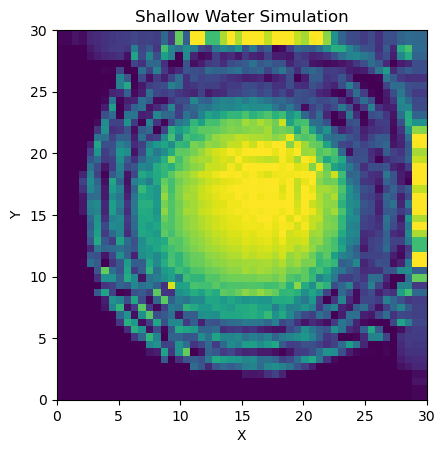

In [4]:
animate_simulation_jupyter(metadata, data)